<div style="text-align: center;"> <h1 text-align > The Grecian Computer Puzzle </h1> </div>


In the Grecian computer puzzle, we have 4 different wheels that spin on a fixed circle plate. Together, these wheels and plate make up 12 columns of up to 4 numbers each. The object of the puzzle is to align the wheels so that each column adds up to 42. 

Each entry in the puzzle is a culmination of layers, with the top most entry showing. Each wheel also has empty sections that reveal the number on the bottom. If all the wheels contribute an empty spot, there are some numbers inscribed on the plate themselves that will then be revealed.


I looked online for pictures of the puzzle disassembled. It turns out the individual wheels can be found here: https://community.wolfram.com/groups/-/m/t/2308671 

The author of this was also interested in solving the puzzle comptationally. While I don't want to use their algorithms or ideas, I'll gladly outsource the work of dissecting the puzzle since I would almost certainly break it in the process! (**Note -- the images of the individual wheels have been removed in this copy due to Github's restrictions on large (>100MB) files**)


My first step is to "orient" the wheels. I want to pick a unique number on the wheel's outermost edge so I can easily identify it. 

The wheels themselves will be represented by a 12 by 4 array. Each entry represents the 4 entries of the column starting from the innermost value to the outermost value.  We can see that there are then 12^4 =20,736 puzzle configurations, making brute force a valid approach.

Here is my initial position. (**Note -- picture removed as wheel due to aforementioned github constraints **)


Going from bottom to top and looking at unique numbers on the outermost sections of the wheels, I oriented 16 to top for the plate,  1 to top for the fourth wheel, 22 to top for the third wheel, 14 to top for the second wheel, and 10 to top for the first and smallest wheel.

In [1]:
#16 is pointed "north"
plate = [[11,12,21,16],[14,13,21,8],[11,14,9,7], [14,15,9,8], [11,4,4,8],
         [11,5,4,3],[14,6,6,4], [11,7,6,12],[14,8,3,2],[11,9,3,5],[14,10,14,10],
         [14,11,14,7]]

#1 is pointed "north"
wheel4 = [[7,9,3,1],[0,20,26,0],[9,12,6,9],[0,3,0,0],
         [7,6,2,12],[14,0,13,0], [11,14,9,6],[0,12,0,0],[8,3,17,10],
          [0,8,19,0],[16,9,3,10],[2,0,12,0]]
#22 is pointed "north"
wheel3 = [[17,11,22,0],[4,26,0,0],[5,14,16,0],[0,1,0,0],[7,12,9,0], [8,0,0,0],
         [9,21,5,0], [13,6,0,0],[9,15,10,0],[7,4,0,0], [13,9,8,0], [21,18,0,0]]

#14 is pointed "north"
wheel2 = [[11,14,0,0], [6,0,0,0],[11,9,0,0],[0,0,0,0],[6,12,0,0],[17,0,0,0],
         [7,4,0,0],[3,0,0,0], [0,7,0,0], [6,15,0,0],[0,0,0,0],[11,0,0,0]]

#10 is pointed "north"
wheel1 = [[10,0,0,0],[0,0,0,0],[7,0,0,0],[0,0,0,0],[15,0,0,0],[0,0,0,0],
         [8,0,0,0],[0,0,0,0],[3,0,0,0],[0,0,0,0],[6,0,0,0],[0,0,0,0]]

len(wheel1)

12

In [2]:
from copy import copy
from copy import deepcopy

def rotate_wheel(wheel):
    w = deepcopy(wheel)
    last = w.pop()
    return [last] + w

def multi_rotate_wheel(wheel, num):
    for i in range(num):
        wheel = rotate_wheel(wheel)
        
    return wheel

def get_first_nonzero(a):
    
    for i in range(len(a)):
        if a[i] != 0:
            return a[i]
    return 0


In [3]:
def make_full_wheel(wheel1,wheel2,wheel3,wheel4,plate):
    
    full_wheel = [[0,0,0,0] for i in range(12)]
    
    for j in range(12):
        for i in range(4):
            
            #j is the column. i is the index within the column, which does from innermost value to outermost
            
            values = [wheel1[j][i], wheel2[j][i],wheel3[j][i], wheel4[j][i], plate[j][i]]
            full_wheel[j][i] = get_first_nonzero(values)
            
    
    
    return full_wheel

make_full_wheel(wheel1,wheel2,wheel3,wheel4,plate)

# the top values of my current wheel.


def check_wheel(wheel):
    
    for i in wheel:
        if sum(i) != 42:
            return False
    return True


def solve_wheel(wheel1,wheel2,wheel3,wheel4,plate):
    
    for a in range(12):
        for b in range(12):
            for c in range(12):
                for d in range(12):
                    wheel = make_full_wheel(multi_rotate_wheel(wheel1, a) , multi_rotate_wheel(wheel2, b) ,
                                           multi_rotate_wheel(wheel3, c), multi_rotate_wheel(wheel4, d), plate)
                    
                    if check_wheel(wheel):
                        print(wheel)
                        return "All turns are clockwise. To solve, turn wheel1 " + str(a) + " times. Turn wheel2 " + str(b) + " times. Turn wheel3 "  + str(c) + " times. Turn wheel4 " + str(d) + " times"

solve_wheel(wheel1,wheel2,wheel3,wheel4,plate)

[[6, 15, 9, 12], [8, 13, 13, 8], [10, 21, 5, 6], [11, 14, 9, 8], [7, 15, 10, 10], [11, 9, 19, 3], [15, 9, 8, 10], [6, 12, 12, 12], [8, 11, 22, 1], [7, 4, 26, 5], [3, 14, 16, 9], [14, 7, 14, 7]]


'All turns are clockwise. To solve, turn wheel1 2 times. Turn wheel2 3 times. Turn wheel3 8 times. Turn wheel4 8 times'

<div style="text-align: center;"> <h1 text-align > The Completed Puzzle </h1> </div>

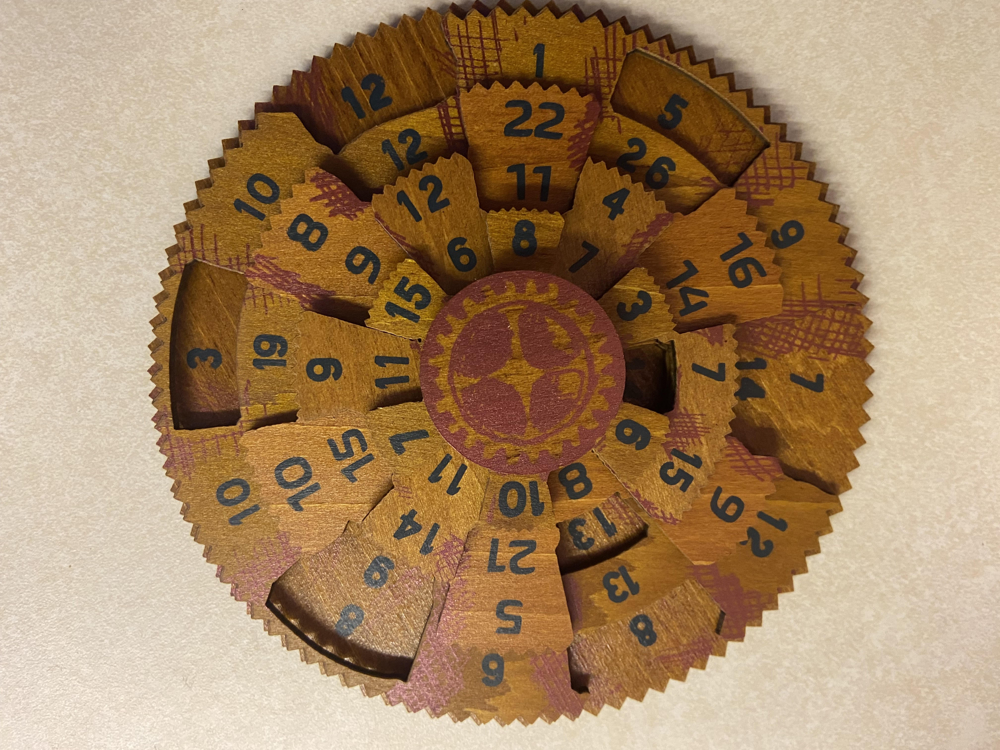

The very dark value that is tough to see in the  is a 14. So the full column reads 14-7-14-7, using our notation that the innermost value is listed first all the way to the outermost one.